In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from lightning import pytorch as pl
from sklearn.model_selection import train_test_split
import torch
torch.set_float32_matmul_precision('medium')
from chemprop import data, featurizers, models, nn
pl.seed_everything(1)
from utils import *
# from data_utils import data_prep, prep_data, load_data, split_data, preprocess_data, create_data_loaders, create_mpnn_model
%load_ext autoreload
%autoreload 2


Seed set to 1
Seed set to 1


In [2]:
input_path = r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\data\nist\nist_train.parquet"
num_workers = 0 # number of workers for dataloader. 0 means using main process for data loading
smiles_column = "smiles" # name of the column containing SMILES strings
target_columns = np.arange(400,4002,2).astype(str) # list of names of the columns containing targets
df_input = pd.read_parquet(input_path)

nist_test_path = r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\data\nist\nist_test.parquet"
nist_test_df = pd.read_parquet(nist_test_path)
test_datapoints = get_mol_datapoints(nist_test_df, smiles_column, target_columns)
test_dset = data.MoleculeDataset(test_datapoints, featurizers.SimpleMoleculeMolGraphFeaturizer())
test_loader = data.MolGraphDataLoader(test_dset, num_workers=num_workers)

def create_rndm_loader(test_data):
    featurizer = featurizers.SimpleMoleculeMolGraphFeaturizer()


    test_dset = data.MoleculeDataset(test_data, featurizer)

    return data.MolGraphDataLoader(test_dset, num_workers=0)

# rndm_test_loader = create_rndm_loader(test_1[:700])

In [3]:
datapoints = get_mol_datapoints(df_input, smiles_column, target_columns)

train_idx, val_idx, test_idx = data.splitting.split_data(
    datapoints,
    num_folds=8,
    split='cv',
)

train_1 = [datapoints[i] for i in train_idx[0]]
val_1 = [datapoints[i] for i in val_idx[0]]
test_1 = [datapoints[i] for i in test_idx[0]]

train_2 = [datapoints[i] for i in train_idx[1]]
val_2 = [datapoints[i] for i in val_idx[1]]
test_2 = [datapoints[i] for i in test_idx[1]]

train_3 = [datapoints[i] for i in train_idx[2]]
val_3 = [datapoints[i] for i in val_idx[2]]
test_3 = [datapoints[i] for i in test_idx[2]]

train_4 = [datapoints[i] for i in train_idx[3]]
val_4 = [datapoints[i] for i in val_idx[3]]
test_4 = [datapoints[i] for i in test_idx[3]]

train_5 = [datapoints[i] for i in train_idx[4]]
val_5 = [datapoints[i] for i in val_idx[4]]
test_5 = [datapoints[i] for i in test_idx[4]]

train_6 = [datapoints[i] for i in train_idx[5]]
val_6 = [datapoints[i] for i in val_idx[5]]
test_6= [datapoints[i] for i in test_idx[5]]

train_7 = [datapoints[i] for i in train_idx[6]]
val_7 = [datapoints[i] for i in val_idx[6]]
test_7 = [datapoints[i] for i in test_idx[6]]

train_8 = [datapoints[i] for i in train_idx[7]]
val_8 = [datapoints[i] for i in val_idx[7]]
test_8 = [datapoints[i] for i in test_idx[7]]

def create_data_loaders(train_data, val_data, test_data, num_workers=0):
    featurizer = featurizers.SimpleMoleculeMolGraphFeaturizer()

    train_dset = data.MoleculeDataset(train_data, featurizer)
    val_dset = data.MoleculeDataset(val_data, featurizer)
    test_dset = data.MoleculeDataset(test_data, featurizer)

    train_loader = data.MolGraphDataLoader(train_dset, num_workers=num_workers)
    val_loader = data.MolGraphDataLoader(val_dset, num_workers=num_workers, shuffle=False)
    test_loader = data.MolGraphDataLoader(test_dset, num_workers=num_workers, shuffle=False)

    return train_loader, val_loader, test_loader

train_loader_1, val_loader_1, test_loader_1 = create_data_loaders(train_1, val_1, test_1, num_workers)
train_loader_2, val_loader_2, test_loader_2 = create_data_loaders(train_2, val_2, test_2, num_workers)
train_loader_3, val_loader_3, test_loader_3 = create_data_loaders(train_3, val_3, test_3, num_workers)
train_loader_4, val_loader_4, test_loader_4 = create_data_loaders(train_4, val_4, test_4, num_workers)
train_loader_5, val_loader_5, test_loader_5 = create_data_loaders(train_5, val_5, test_5, num_workers)
train_loader_6, val_loader_6, test_loader_6 = create_data_loaders(train_6, val_6, test_6, num_workers)
train_loader_7, val_loader_7, test_loader_7 = create_data_loaders(train_7, val_7, test_7, num_workers)
train_loader_8, val_loader_8, test_loader_8 = create_data_loaders(train_8, val_8, test_8, num_workers)

In [4]:
pre_trained_model_1 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\modified_mpnn_1.ckpt")
pre_trained_model_2 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\modified_mpnn_2.ckpt")
pre_trained_model_3 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\modified_mpnn_3.ckpt")
pre_trained_model_4 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\modified_mpnn_4.ckpt")
pre_trained_model_5 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\modified_mpnn_5.ckpt")
pre_trained_model_6 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\modified_mpnn_6.ckpt")
pre_trained_model_7 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\modified_mpnn_7.ckpt")
pre_trained_model_8 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\modified_mpnn_8.ckpt")

pre_trained_models = [pre_trained_model_1, pre_trained_model_2, pre_trained_model_3, pre_trained_model_4, pre_trained_model_5, pre_trained_model_6, pre_trained_model_7, pre_trained_model_8]



In [ ]:
trainer_1 = pl.Trainer(
    precision='bf16-mixed',
    logger=True,
    enable_checkpointing=False, # Use `True` if you want to save model checkpoints. The checkpoints will be saved in the `checkpoints` folder.
    enable_progress_bar=True,
    accelerator="auto",
    devices=1,
    max_epochs=2, # number of epochs to train for
    # callbacks=[metric_tracker, early_stop_callback]
)

In [ ]:
def train_and_test(model, train_dataloader, test_dataloader, num_epochs, num_cycles):
    trainer = pl.Trainer(
    precision='bf16-mixed',
    logger=True,
    enable_checkpointing=False, # Use `True` if you want to save model checkpoints. The checkpoints will be saved in the `checkpoints` folder.
    enable_progress_bar=True,
    accelerator="auto",
    devices=1,
    max_epochs=num_epochs, # number of epochs to train for
    # callbacks=[metric_tracker, early_stop_callback]
)
    
    all_test_values = []
    all_predictions = []
    
    for cycle in range(num_cycles):
        print(f"Cycle {cycle + 1}")
        
        # Train the model for the specified number of epochs
        trainer.fit(model, train_dataloader)
        
        # Test the model and calculate predictions
        test_values = trainer.test(model, test_dataloader)
        predictions = trainer.predict(model, test_dataloader)
        
        
        all_test_values.append(test_values)
        all_predictions.append(predictions)
        
        # Print the predictions or perform any desired analysis
        print("Predictions:", predictions)
    
    return all_test_values, all_predictions





# Specify the number of epochs per cycle and the number of cycles
num_epochs_per_cycle = 2
num_cycles = 100

# Call the train_and_test function
test_values, predictions = train_and_test(pre_trained_model_1, train_loader_1, test_loader, num_epochs_per_cycle, num_cycles)

In [ ]:
# Extract the RMSE values
rmse_values = [item[0]['test/rmse'] for item in test_values]

# Create a range of numbers for the x-axis (time)
time = range(len(rmse_values))

# Create the plot
plt.plot(time, rmse_values)

# Add title and labels
plt.title('RMSE over time')
plt.xlabel('Time')
plt.ylabel('RMSE')

# Show the plot
plt.show()





In [ ]:
rmse_values = [item[0]['test/rmse'] for item in test_values]

# Find the index of the lowest RMSE
lowest_rmse_index = np.argmin(rmse_values)

In [ ]:




plt.plot(np.arange(400,4002,2), predictions[0][0].detach().float().numpy().flatten(), label="Epochs: 2")
plt.plot(np.arange(400,4002,2), predictions[1][0].detach().float().numpy().flatten(), label="Epochs: 4")
plt.plot(np.arange(400,4002,2), predictions[2][0].detach().float().numpy().flatten(), label="Epochs: 6")
plt.plot(np.arange(400,4002,2), predictions[3][0].detach().float().numpy().flatten(), label="Epochs: 8")
plt.plot(np.arange(400,4002,2), predictions[4][0].detach().float().numpy().flatten(), label="Epochs: 10")
plt.plot(np.arange(400,4002,2), test_loader.dataset[0].y, label="True")
plt.legend()
plt.show()


In [ ]:
# plt.plot(np.arange(400,4002,2), pt_model_1_preds[6].detach().cpu().numpy().squeeze(), label="Model 1")
# plt.plot(np.arange(400,4002,2), test_loader.dataset[6].y, label="True")

In [ ]:
def calculate_rmse(predicted_spectra, reference_spectra):
    if len(predicted_spectra) != len(reference_spectra):
        print(len(predicted_spectra), len(reference_spectra))
        raise ValueError("Length of predicted and reference spectra lists should be the same.")

    rmse_values = []

    for i in range(len(predicted_spectra)):
        predicted = np.array(predicted_spectra[i]).squeeze()
        reference = np.array(reference_spectra[i]).squeeze()

        if len(predicted) != len(reference):
            print(len(predicted), len(reference))
            raise ValueError(f"Length of predicted and reference spectra at index {i} should be the same.")

        mse = np.mean((predicted - reference) ** 2)
        rmse = np.sqrt(mse)
        rmse_values.append(rmse)

    return rmse_values

def calculate_sis(predicted_spectra, reference_spectra):
    if len(predicted_spectra) != len(reference_spectra):
        print(len(predicted_spectra), len(reference_spectra))
        raise ValueError("Length of predicted and reference spectra lists should be the same.")

    sis_values = []

    for i in range(len(predicted_spectra)):
        predicted = np.array(predicted_spectra[i]).squeeze()
        reference = np.array(reference_spectra[i]).squeeze()

        if len(predicted) != len(reference):
            print(len(predicted), len(reference))
            raise ValueError(f"Length of predicted and reference spectra at index {i} should be the same.")

        # Set any negative values to zero
        predicted[predicted < 0] = 0
        reference[reference < 0] = 0

        # Add a small constant to avoid taking log of zero
        epsilon = 1e-10
        predicted += epsilon
        reference += epsilon

        # Ensure the spectra are normalized
        predicted = predicted / np.sum(predicted)
        reference = reference / np.sum(reference)

        # Check for negative values
        if np.any(predicted < 0) or np.any(reference < 0):
            raise ValueError("Spectra contain negative values")

        # Check for zero values
        if np.any(predicted == 0) or np.any(reference == 0):
            raise ValueError("Spectra contain zero values")

        # Calculate the SID
        sid = np.sum(predicted * np.log(predicted / reference)) + np.sum(reference * np.log(reference / predicted))

        # Calculate the SIS
        sis = 1 / (1 + sid)
        sis_values.append(sis)

    return sis_values

# rmse = calculate_rmse(pt_model_1_preds, [test_loader.dataset[i].y for i in range(len(test_loader.dataset))])

# sis = calculate_sis(pt_model_1_preds, [test_loader.dataset[i].y for i in range(len(test_loader.dataset))])

predictions = [[tensor.float() for tensor in pred_list] for pred_list in predictions]

fine_tuned_rmse = calculate_rmse(predictions[lowest_rmse_index], [test_loader.dataset[i].y for i in range(len(test_loader.dataset))])

fine_tuned_sis = calculate_sis(predictions[lowest_rmse_index], [test_loader.dataset[i].y for i in range(len(test_loader.dataset))])

In [ ]:
plt.hist(rmse, bins=26)

In [ ]:
plt.hist(sis, bins=26)

In [ ]:
plt.hist(fine_tuned_rmse, bins=26)

In [ ]:
plt.hist(fine_tuned_sis, bins=26)

In [ ]:
# qm9s_fine_tuned_results = pd.DataFrame({
#     "rmse": fine_tuned_rmse,
#     "sis": fine_tuned_sis
# })

# qm9s_fine_tuned_results.to_csv(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\results\qm9s_fine_tuned_results.csv", index=False)

# qm9s_fine_tuned_results.describe()



In [17]:
def train_and_test(model, train_dataloader, test_dataloader, num_epochs, num_cycles):
    trainer = pl.Trainer(
        precision='bf16-mixed',
        logger=True,
        enable_checkpointing=False,
        enable_progress_bar=True,
        accelerator="auto",
        devices=1,
        max_epochs=num_epochs,
    )
    
    all_test_values = []
    all_predictions = []
    all_models = []  # List to store the trained models for each cycle
    all_trainers = []
    for cycle in range(num_cycles):
        print(f"Cycle {cycle + 1}")
        
        trainer.fit(model, train_dataloader)
        
        test_values = trainer.test(model, test_dataloader)
        predictions = trainer.predict(model, test_dataloader)
        
        all_test_values.append(test_values)
        all_predictions.append(predictions)
        all_models.append(model)  # Store the trained model for each cycle
        all_trainers.append(trainer)
        print("Predictions:", predictions)
    
    return all_test_values, all_predictions, all_models, all_trainers  # Return the trained models as well

# Specify the number of epochs per cycle and the number of cycles
num_epochs_per_cycle = 2
num_cycles = 50

# List to store the results for each pre-trained model
all_models_test_values = []
all_models_predictions = []
all_trained_models = []  # List to store the trained models for each pre-trained model
all_trainers = []
# Iterate over the eight pre-trained models
for i in range(1, 9):
    print(f"Fine-tuning pre_trained_model_{i}")
    
    # Get the pre-trained model and corresponding train dataloader
    model = globals()[f"pre_trained_model_{i}"]
    train_dataloader = globals()[f"train_loader_{i}"]
    
    # Call the train_and_test function for the current model
    test_values, predictions, trained_models, trainers = train_and_test(model, train_dataloader, test_loader, num_epochs_per_cycle, num_cycles)
    
    # Store the results for the current model
    all_models_test_values.append(test_values)
    all_models_predictions.append(predictions)
    all_trained_models.append(trained_models)  # Store the trained models for each pre-trained model
    all_trainers.append(trainers)



Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\configuration_validator.py:74: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\chemprop\schedulers.py:92: RuntimeWarning: divide by zero encountered in divide
  gammas = (self.final_lrs / max_lrs) ** (1 / cooldow

Fine-tuning pre_trained_model_1
Cycle 1
Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 26.65it/s, v_num=83, train/loss=0.00383]

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 26.63it/s, v_num=83, train/loss=0.00383]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.08it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07574637234210968
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:492: Your `predict_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 176.16it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0422,  ..., -0.0062, -0.0052, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0216,  0.0203,  0.0219,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0062, 0.0063, 0.0068,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0183, 0.0181, 0.0187,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.51it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07552996277809143
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 181.00it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0756949782371521
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.01it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
    

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0759081095457077
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.55it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0422,  ..., -0.0062, -0.0052, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0215,  0.0201,  0.0219,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0068,  ..., 0.0027, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0182, 0.0181, 0.0187,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0275, 0.0273

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07585684955120087
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.70it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.99it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07511447370052338
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 181.75it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.22it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07547196000814438
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.04it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.01it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0755353793501854
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 166.49it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
    

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.60it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07413076609373093
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.28it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0422,  ..., -0.0062, -0.0053, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0215,  0.0203,  0.0219,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0068,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0065, 0.0073, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0182, 0.0181, 0.0187,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0275, 0.0273


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07531263679265976
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 164.80it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.90it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07580199092626572
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.23it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0280, 0.0275,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0422,  ..., -0.0062, -0.0052, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0215,  0.0201,  0.0219,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0068,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0182, 0.0181, 0.0187,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0273, 0.0273

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07579954713582993
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 166.99it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0422,  ..., -0.0062, -0.0052, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0215,  0.0201,  0.0219,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0068,  ..., 0.0027, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0182, 0.0181, 0.0187,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0275, 0.0275


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.22it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07607575505971909
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.97it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0106, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.36it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07562442868947983
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 201.52it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0106, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0420,  ..., -0.0062, -0.0052, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0216,  0.0204,  0.0220,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0062, 0.0067,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0065, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0182, 0.0181, 0.0187,  ..., 0.0153, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0275, 0.0273


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.84it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07585952430963516
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 201.15it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.45it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07558386027812958
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.88it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0106, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 49.08it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07559673488140106
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.86it/s]
Predictions: [tensor([[0.0134, 0.0134, 0.0143,  ..., 0.0106, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 48.19it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0755486935377121
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 199.43it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
    

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 49.23it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07534658163785934
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 199.53it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0280, 0.0275,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 47.76it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07580068707466125
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.27it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0422,  ..., -0.0062, -0.0053, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0216,  0.0203,  0.0219,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0068,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0182, 0.0181, 0.0187,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0275, 0.0273


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.82it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07555823773145676
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.08it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0106, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0275,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0420,  ..., -0.0062, -0.0052, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0216,  0.0204,  0.0220,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0062, 0.0062, 0.0068,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0065, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0183, 0.0181, 0.0187,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0275, 0.0273

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.37it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0151, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0275,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0420,  ..., -0.0062, -0.0053, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0216,  0.0203,  0.0220,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0068,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0183, 0.0181, 0.0187,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0273, 0.0273


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.07it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07552070915699005
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.98it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.60it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07573989778757095
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.49it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.69it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07567993551492691
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 153.89it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0151, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0420,  ..., -0.0062, -0.0053, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0215,  0.0203,  0.0219,  ..., -0.0025, -0.0020, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0068,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0183, 0.0181, 0.0187,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0273, 0.0273


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.45it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07554300874471664
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 181.07it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0106, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0280, 0.0275,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0420,  ..., -0.0062, -0.0052, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0216,  0.0203,  0.0220,  ..., -0.0025, -0.0020, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0062, 0.0068,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0065, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0183, 0.0181, 0.0187,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0273, 0.0273


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07569523900747299
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 168.00it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.80it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07556583732366562
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 177.75it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0106, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0422,  ..., -0.0062, -0.0053, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0216,  0.0203,  0.0219,  ..., -0.0025, -0.0020, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0062, 0.0068,  ..., 0.0027, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0182, 0.0181, 0.0186,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0273, 0.0273


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.83it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07576609402894974
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 164.17it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.74it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0758390724658966
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 180.51it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
    

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.51it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07589206099510193
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.83it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0106, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0074,  ..., 0.0143, 0.0151, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.55it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07548317313194275
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.58it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0280, 0.0275,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0420,  ..., -0.0061, -0.0052, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0215,  0.0203,  0.0219,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0068,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0182, 0.0181, 0.0186,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0275, 0.0273

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 184.86it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0280, 0.0275,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0420,  ..., -0.0062, -0.0052, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0215,  0.0201,  0.0219,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0068,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0183, 0.0181, 0.0187,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.22it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07563061267137527
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 167.65it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.22it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07524742186069489
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 183.27it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0106, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07571613043546677
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 166.59it/s]
Predictions: [tensor([[0.0135, 0.0134, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.19it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07554847747087479
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.41it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0275,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0427,  0.0420,  ..., -0.0061, -0.0052, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0216,  0.0204,  0.0220,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0062, 0.0062, 0.0067,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0182, 0.0181, 0.0187,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.56it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07593660056591034
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 162.02it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0106, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0422,  ..., -0.0062, -0.0052, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0216,  0.0203,  0.0220,  ..., -0.0025, -0.0020, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0062, 0.0062, 0.0068,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0182, 0.0181, 0.0187,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0273, 0.0273


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07565727084875107
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.73it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0422,  ..., -0.0062, -0.0052, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0216,  0.0203,  0.0219,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0062, 0.0068,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0183, 0.0182, 0.0187,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0273, 0.0273


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07513473182916641
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 170.16it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0144,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.20it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07372353971004486
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.61it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0106, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0420,  ..., -0.0062, -0.0053, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0215,  0.0203,  0.0219,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0062, 0.0062, 0.0067,  ..., 0.0027, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0065, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0183, 0.0181, 0.0187,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.03it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0758766159415245
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.36it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
    

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.66it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07612050324678421
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.64it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.92it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07555438578128815
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 155.42it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0420,  ..., -0.0061, -0.0052, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0216,  0.0203,  0.0220,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0068,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0182, 0.0181, 0.0187,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0275, 0.0273


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.87it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07563915103673935
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.90it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0151, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0422,  ..., -0.0062, -0.0052, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0216,  0.0203,  0.0219,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0068,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0183, 0.0181, 0.0187,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0275, 0.0273


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0753273218870163
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 167.98it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0106, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
    

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.93it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07595287263393402
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.90it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.28it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07581853866577148
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 183.14it/s]
Predictions: [tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0193, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0422,  ..., -0.0062, -0.0053, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0215,  0.0201,  0.0219,  ..., -0.0025, -0.0020, -0.0014]],
       dtype=torch.bfloat16), tensor([[0.0062, 0.0062, 0.0067,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0065, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0183, 0.0182, 0.0187,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.90it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07585464417934418
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.83it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0094, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0076, 0.0073,  ..., 0.0143, 0.0151, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0192]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0420,  ..., -0.0062, -0.0052, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0216,  0.0203,  0.0220,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0062, 0.0062, 0.0067,  ..., 0.0027, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0183, 0.0181, 0.0187,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0273, 0.0273


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07591618597507477
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 166.13it/s]
Predictions: 

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True


[tensor([[0.0135, 0.0135, 0.0143,  ..., 0.0105, 0.0093, 0.0110]],
       dtype=torch.bfloat16), tensor([[0.0074, 0.0075, 0.0073,  ..., 0.0143, 0.0150, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0278, 0.0273,  ..., 0.0194, 0.0187, 0.0188]],
       dtype=torch.bfloat16), tensor([[0.0315, 0.0317, 0.0312,  ..., 0.0198, 0.0190, 0.0193]],
       dtype=torch.bfloat16), tensor([[-0.0085, -0.0090, -0.0081,  ...,  0.0168,  0.0166,  0.0170]],
       dtype=torch.bfloat16), tensor([[ 0.0420,  0.0430,  0.0420,  ..., -0.0062, -0.0053, -0.0045]],
       dtype=torch.bfloat16), tensor([[ 0.0215,  0.0203,  0.0219,  ..., -0.0025, -0.0021, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0062, 0.0062, 0.0067,  ..., 0.0026, 0.0042, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0391, 0.0400, 0.0398,  ..., 0.0064, 0.0072, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0182, 0.0181, 0.0187,  ..., 0.0154, 0.0159, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0275, 0.0275

TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


Cycle 1
Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.85it/s, v_num=84, train/loss=0.00393]

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.84it/s, v_num=84, train/loss=0.00393]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.55it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07619469612836838
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 160.03it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0138]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0415, 0.0417, 0.0417,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0237, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0342, 0.0342,  ..., 0.0100, 0.0104, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0179,  ..., 0.0096, 0.0095, 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.51it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07620188593864441
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 175.82it/s]
Predictions: [tensor([[0.0289, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.71it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07595135271549225
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.40it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0138]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0366, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0240,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0238,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.71it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0758134126663208
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.90it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dty

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.94it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07594013214111328
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.12it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.80it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0761134997010231
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.17it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0138]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0240,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0099, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0238,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07595691084861755
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.17it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0237, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0238,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.67it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07613138854503632
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.13it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0366, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0342, 0.0342,  ..., 0.0100, 0.0104, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0179,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0238,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.99it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07606319338083267
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.67it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0289, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0366, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0237, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0342, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0239,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.81it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07568798214197159
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.37it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0262, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.11it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07602138817310333
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 191.92it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0138]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0366, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0415, 0.0417, 0.0415,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0237, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0101, 0.0104, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0238,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.89it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07612070441246033
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 191.85it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07584083825349808
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.56it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0366, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0342, 0.0342,  ..., 0.0100, 0.0104, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0239,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07623540610074997
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.38it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.60it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0758683905005455
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.37it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0096, 0.0094, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0240, 0.0243,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0415, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0237, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0239,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.10it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07568278163671494
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.68it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.07it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07577557861804962
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.80it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0289, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0096, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0366, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0238,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.92it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07614848762750626
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.76it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0238,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.96it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07605148106813431
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.04it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0096, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0415, 0.0417, 0.0417,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0240,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0239,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.83it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07595168799161911
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 176.38it/s]
Predictions: [tensor([[0.0289, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.56it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07606127858161926
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.31it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0138]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.57it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07618845254182816
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 202.11it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0366, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0242,  ..., 0.0060, 0.0055, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0104, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0179,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0234, 0.0238,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.40it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07589226961135864
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.08it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07620459794998169
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:17<00:00, 43.90it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0177, 0.0179, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0238,  ..., 0.0090, 0.

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07600042223930359
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.54it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0138]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0415, 0.0415,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0234, 0.0238,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.44it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0761318951845169
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.83it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0289, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0366, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0240,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0179,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0238,  ..., 0.0090, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 48.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07572677731513977
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.62it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0366, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0415, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0237, 0.0242,  ..., 0.0060, 0.0055, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0342, 0.0342,  ..., 0.0100, 0.0104, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0233, 0.0238,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.10it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07603180408477783
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.83it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.10it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07599179446697235
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.85it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0138]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0239,  ..., 0.0090, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07632564753293991
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.62it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0138]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0237, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0238,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 47.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07566878199577332
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.11it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0366, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0099, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0234, 0.0238,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07608093321323395
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.52it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0237, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0239,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.95it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07634501904249191
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.48it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0366, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0415, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0237, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0239,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.07it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07576068490743637
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.54it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0237, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0342, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0179,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0238,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.94it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07596126198768616
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 180.72it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0289, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0366, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0415, 0.0415,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0239,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07601254433393478
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.37it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0415, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0179,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0239,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.45it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07595890015363693
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.77it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0138]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0366, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0240,  ..., 0.0060, 0.0055, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0342, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0179,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0238,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0762600526213646
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.83it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0138]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0366, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0239,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 47.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07580379396677017
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.71it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.02it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07623470574617386
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 200.84it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0138]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.46it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07432586699724197
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 199.79it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0366, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0240,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0342, 0.0342,  ..., 0.0100, 0.0104, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0239,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 48.05it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07570693641901016
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 200.10it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0138]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.07it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07592252641916275
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.73it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 46.92it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0759885162115097
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 200.73it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dty

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.32it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07600851356983185
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 199.95it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0096, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.71it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse            0.075897216796875
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.45it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0415, 0.0417, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0237, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0101, 0.0104, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0179,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0239,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.44it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07599936425685883
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 191.85it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0070, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0237, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0239,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.08it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07609299570322037
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.71it/s]
Predictions: [tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0138]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.99it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07417592406272888
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.84it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0288, 0.0289, 0.0291,  ..., 0.0140, 0.0135, 0.0139]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0095,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0240, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0366, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0415, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0237, 0.0242,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0179,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0234, 0.0239,  ..., 0.0090, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.13it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07625585049390793
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.35it/s]
Predictions: 

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0288, 0.0289, 0.0289,  ..., 0.0140, 0.0135, 0.0138]],
       dtype=torch.bfloat16), tensor([[0.0095, 0.0093, 0.0096,  ..., 0.0032, 0.0029, 0.0034]],
       dtype=torch.bfloat16), tensor([[0.0237, 0.0239, 0.0242,  ..., 0.0124, 0.0125, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0260, 0.0264, 0.0265,  ..., 0.0114, 0.0117, 0.0109]],
       dtype=torch.bfloat16), tensor([[0.0120, 0.0124, 0.0122,  ..., 0.0043, 0.0040, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0364, 0.0369, 0.0366,  ..., 0.0190, 0.0195, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0413, 0.0417, 0.0415,  ..., 0.0071, 0.0069, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0236, 0.0240,  ..., 0.0060, 0.0056, 0.0051]],
       dtype=torch.bfloat16), tensor([[0.0347, 0.0339, 0.0342,  ..., 0.0100, 0.0103, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0176, 0.0178, 0.0181,  ..., 0.0096, 0.0095, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0234, 0.0238,  ..., 0.0090, 0.

Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.43it/s, v_num=85, train/loss=0.00326]

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.41it/s, v_num=85, train/loss=0.00326]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.80it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07932080328464508
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.02it/s]
Predictions: [tensor([[0.0075, 0.0090, 0.0077,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0104,  0.0103,  0.0104,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0309, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.01

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.67it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.08004237711429596
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 178.04it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0075, 0.0090, 0.0077,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0576,  ..., 0.0130, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0306, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0574, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07922468334436417
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.66it/s]
Predictions: [tensor([[0.0076, 0.0091, 0.0077,  ..., 0.0151, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0033, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0106,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.34it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07913023978471756
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.26it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0077,  ..., 0.0151, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0067, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0131, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0306, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0198, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.82it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07952848076820374
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.20it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0075, 0.0091, 0.0077,  ..., 0.0151, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0106,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0576,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0306, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0571, 0.0574, 0.0552,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0200, 0.0198,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0258, 0.0251, 0.0254,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.61it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07964771240949631
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.04it/s]
Predictions: [tensor([[0.0074, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0033, 0.0034,  ..., 0.0067, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0106,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0306, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.01

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07939373701810837
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.54it/s]
Predictions: [tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0067, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.11it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07963364571332932
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.54it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0135,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0104,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0308, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0251, 0.0253,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.13it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07982991635799408
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.99it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0104,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0566, 0.0574,  ..., 0.0130, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0308, 0.0309, 0.0306,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07958833128213882
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.89it/s]
Predictions: [tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0136,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.20it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07938290387392044
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 175.03it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0135,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...

Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.02it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07943439483642578
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.58it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0077,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0067, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0106,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0306, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.20it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07921051234006882
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.48it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0067, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0571, 0.0569, 0.0576,  ..., 0.0130, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0309, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0571, 0.0574, 0.0552,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0198, 0.0203, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.22it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07937274128198624
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.24it/s]
Predictions: [tensor([[0.0075, 0.0090, 0.0077,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0136,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.82it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0795663595199585
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.71it/s]
Predictions: [tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0106,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.46it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.08022107928991318
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 175.31it/s]
Predictions: [tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0067, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.70it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0792996734380722
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.08it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0077,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0571, 0.0574, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.93it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0799889862537384
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 167.72it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0135,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0106,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.80it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07926609367132187
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.22it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0135,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0104,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0422,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0566, 0.0574,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0306, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.44it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07951398193836212
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 167.18it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0147, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0135,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0566, 0.0574,  ..., 0.0130, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0571, 0.0574, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0251, 0.0254,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07951828092336655
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.01it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0135,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0104,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0422,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0576,  ..., 0.0130, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0306, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0574, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0198, 0.0203, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0258, 0.0251, 0.0254,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.51it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07872845232486725
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 169.99it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0077,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0104,  0.0103,  0.0104,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0308, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0574, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0258, 0.0251, 0.0254,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.19it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.08040269464254379
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 181.41it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0151, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0135,  0.0135,  ..., -0.0002, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0010]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0576,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0571, 0.0574, 0.0552,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0784323439002037
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.17it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0135,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0576,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0574, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0198, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0258, 0.0251, 0.0254,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.03it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07845110446214676
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 191.75it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0067, 0.0066, 0.0064]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0104,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0576,  ..., 0.0130, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0308, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0251, 0.0253,  ...

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.46it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0791715532541275
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.85it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0258, 0.0251, 0.0254,  ...

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.51it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07926642149686813
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.42it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0077,  ..., 0.0151, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0067, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0135,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0106,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0422,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0576,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0251, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.82it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07880804687738419
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.86it/s]
Predictions: [tensor([[0.0075, 0.0091, 0.0077,  ..., 0.0151, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0136,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0104,  0.0104,  0.0104,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.28it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07794485241174698
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.69it/s]
Predictions: [tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0104,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.22it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07987968623638153
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 199.58it/s]
Predictions: [tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0576,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0306, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0571, 0.0574, 0.0552,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0199,  ..., 0.01

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 46.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07878167927265167
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.77it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0077,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0034, 0.0034, 0.0034,  ..., 0.0067, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0135,  0.0135,  ..., -0.0002, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0306, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0574, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0200, 0.0198,  ..., 0.0171, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0251, 0.0254,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07934627681970596
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.62it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0077,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0067, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0566, 0.0574,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0574, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07890584319829941
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.02it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0067, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0106,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0576,  ..., 0.0130, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0258, 0.0251, 0.0254,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.60it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07937938719987869
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 178.87it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0151, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0104,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0571, 0.0574, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.37it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07947389036417007
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 170.86it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0104,  0.0103,  0.0104,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0566, 0.0574,  ..., 0.0130, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0306, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.80it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0794127807021141
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 177.01it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0151, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0034, 0.0034, 0.0035,  ..., 0.0067, 0.0066, 0.0064]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0135,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0106,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.84it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07985356450080872
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 170.48it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0077,  ..., 0.0151, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0195, 0.0200, 0.0197,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0251, 0.0254,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07876318693161011
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.22it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0136,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0131, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0308, 0.0309, 0.0306,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0574, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0251, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.30it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0797417089343071
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 164.06it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0136,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0422,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0306, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.22it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07870876789093018
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.66it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0075, 0.0090, 0.0077,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0135,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0306, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0574, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.71it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0794142633676529
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.37it/s]
Predictions: [tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0135,  0.0135,  ..., -0.0002, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.24it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07939022779464722
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.80it/s]
Predictions: [tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0067, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0106,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0422,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0306, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0199,  ..., 0.01

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.56it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0795990526676178
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 164.13it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0067, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0106,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0422,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0306, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0251, 0.0254,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.28it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07944497466087341
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.86it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0077,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0135,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.28it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07991394400596619
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 164.98it/s]
Predictions: [tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0067, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0135,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.96it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07968955487012863
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.18it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0074, 0.0090, 0.0076,  ..., 0.0151, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0422,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0576,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.19it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07941831648349762
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 163.71it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0136,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0105,  0.0104,  0.0104,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0576,  ..., 0.0130, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0308, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0574, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.0171, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.56it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0796961784362793
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.26it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0034, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0106,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0422,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0130, 0.0129, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0308, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07986817508935928
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.36it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0135,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0106,  0.0104,  0.0105,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0574,  ..., 0.0129, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0308, 0.0304,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0197, 0.0201, 0.0198,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.09it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07978697866201401
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.81it/s]
Predictions: 

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0075, 0.0090, 0.0076,  ..., 0.0150, 0.0148, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0033, 0.0034, 0.0034,  ..., 0.0068, 0.0066, 0.0065]],
       dtype=torch.bfloat16), tensor([[ 0.0137,  0.0136,  0.0136,  ..., -0.0001, -0.0008, -0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0104,  0.0103,  0.0104,  ..., -0.0002, -0.0010, -0.0011]],
       dtype=torch.bfloat16), tensor([[0.0041, 0.0038, 0.0040,  ..., 0.0064, 0.0055, 0.0052]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0427, 0.0420,  ..., 0.0134, 0.0135, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0569, 0.0576,  ..., 0.0130, 0.0128, 0.0132]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0308, 0.0305,  ..., 0.0115, 0.0109, 0.0107]],
       dtype=torch.bfloat16), tensor([[0.0569, 0.0571, 0.0549,  ..., 0.0157, 0.0157, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.0198, 0.0201, 0.0199,  ..., 0.0172, 0.0168, 0.0164]],
       dtype=torch.bfloat16), tensor([[0.0256, 0.0250, 0.0253,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.70it/s, v_num=86, train/loss=0.00363]

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.70it/s, v_num=86, train/loss=0.00363]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.90it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07784254103899002
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 191.94it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0037]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0398, 0.0400,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0171,  ..., 0.0033, 0.0030, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.40it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07774209976196289
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.25it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0049, 0.0048, 0.0058]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0130, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0107, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.55it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0779280960559845
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.84it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0212, 0.0206,  ..., 0.0049, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0292, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0317, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0162, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0171,  ..., 0.0033, 0.0030, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0237, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07799120247364044
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 191.80it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0049, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0332, 0.0330,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0168, 0.0165, 0.0170,  ..., 0.0032, 0.0029, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.92it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07773571461439133
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.70it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0049, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0111,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0444,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0400,  ..., 0.0109, 0.0130, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.99it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07750052213668823
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.56it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0049, 0.0048, 0.0058]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0282, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0503, 0.0498,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.34it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07752016931772232
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.52it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0214, 0.0212, 0.0206,  ..., 0.0049, 0.0048, 0.0058]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0037]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0292, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0130, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0332, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0171,  ..., 0.0033, 0.0030, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0238, 0.0239,  ...

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.95it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07791107892990112
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.30it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0049, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0282, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0332, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0503, 0.0498,  ..., 0.0175, 0.0162, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0171,  ..., 0.0033, 0.0030, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07769820094108582
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.89it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0037]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0332, 0.0330,  ..., 0.0097, 0.0107, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0171,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.71it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07777907699346542
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.44it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0214, 0.0212, 0.0206,  ..., 0.0049, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0037]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0292, 0.0283, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0332, 0.0327,  ..., 0.0097, 0.0107, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0030, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.61it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0773697942495346
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.01it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0049, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0034]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0282, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0398, 0.0400,  ..., 0.0109, 0.0130, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0162, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07767829298973083
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.36it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0037]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0400,  ..., 0.0109, 0.0130, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0332, 0.0330,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0168, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0237, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07809183746576309
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.39it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0214, 0.0212, 0.0206,  ..., 0.0049, 0.0048, 0.0058]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0107, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0171,  ..., 0.0033, 0.0030, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0237, 0.0238,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.72it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07800213247537613
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.07it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0049, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0111,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0282, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0162, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.83it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07765184342861176
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.71it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0282, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0130, 0.0112]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0175, 0.0162, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0168, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.22it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07773196697235107
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.72it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0049, 0.0048, 0.0058]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0171,  ..., 0.0033, 0.0030, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.96it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07762233167886734
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.37it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0049, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0037]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0282, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0332, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.36it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07785257697105408
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.71it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0332, 0.0327,  ..., 0.0097, 0.0107, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0171,  ..., 0.0033, 0.0030, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07777445018291473
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 161.93it/s]
Predictions: [tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0049, 0.0048, 0.0058]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0037]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0776529610157013
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.58it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0214, 0.0212, 0.0206,  ..., 0.0048, 0.0047, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0292, 0.0283, 0.0283,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0171, 0.0166, 0.0171,  ..., 0.0033, 0.0030, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.74it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0780528113245964
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 162.60it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0037]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0034]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0332, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.36it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07758446782827377
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.03it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0212, 0.0206,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0292, 0.0283, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0107, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.31it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07765495777130127
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 158.63it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0037]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0282, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0171,  ..., 0.0033, 0.0030, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.83it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07775185257196426
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.35it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0049, 0.0048, 0.0058]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0400,  ..., 0.0109, 0.0130, 0.0112]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0332, 0.0330,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0237, 0.0238,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.79it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07767442613840103
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 170.56it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0049, 0.0048, 0.0058]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0292, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0332, 0.0330,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0237, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07786650210618973
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.29it/s]
Predictions: [tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0048, 0.0047, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.30it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07764849811792374
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 169.65it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0214, 0.0212, 0.0206,  ..., 0.0049, 0.0048, 0.0058]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0282, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0171, 0.0166, 0.0171,  ..., 0.0033, 0.0030, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.95it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07776647806167603
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.92it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0037]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0332, 0.0330,  ..., 0.0098, 0.0108, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07749982923269272
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 168.61it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0214, 0.0212, 0.0206,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0130, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0332, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0168, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.70it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07722057402133942
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.65it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0048, 0.0047, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0292, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0168, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.03it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse            0.077751025557518
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 167.03it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0212, 0.0206,  ..., 0.0049, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.28it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07791206240653992
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 178.83it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0034]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0332, 0.0330,  ..., 0.0098, 0.0108, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0237, 0.0238,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.93it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07756319642066956
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.73it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0049, 0.0048, 0.0058]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0171,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0238, 0.0239,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07773206382989883
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 184.22it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0292, 0.0283, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0393, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0332, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0171,  ..., 0.0033, 0.0030, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07776585221290588
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.84it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0049, 0.0048, 0.0058]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0037]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0282, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.55it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07777532935142517
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 181.62it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0048, 0.0047, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0111,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0292, 0.0283, 0.0283,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0317, 0.0327, 0.0325,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.61it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0777270495891571
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 184.95it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0282, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0168, 0.0165, 0.0170,  ..., 0.0032, 0.0029, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.91it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07775390148162842
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.90it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0049, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0292, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0400,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0332, 0.0330,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0162, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0168, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0237, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0778629258275032
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.99it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0049, 0.0048, 0.0058]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0282, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0332, 0.0330,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0168, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...

Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.47it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07798565179109573
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.53it/s]
Predictions: [tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0037]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.71it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07816078513860703
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.82it/s]
Predictions: [tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0049, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.93it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0777883380651474
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 176.28it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0049, 0.0048, 0.0058]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0282, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0317, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0171,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.44it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07777179032564163
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.52it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0292, 0.0283, 0.0283,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0332, 0.0330,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0171,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.53it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07743069529533386
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.09it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0049, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0111,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0130, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0332, 0.0330,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.80it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07789779454469681
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.71it/s]
Predictions: [tensor([[0.0214, 0.0212, 0.0206,  ..., 0.0049, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0332, 0.0330,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.00

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.31it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07792259007692337
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.22it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0110, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0037]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0332, 0.0330,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0162, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.19it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07789111137390137
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.20it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0049, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0332, 0.0330,  ..., 0.0098, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.89it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07793302834033966
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 177.26it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0014, -0.0023, -0.0037]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0282, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0332, 0.0330,  ..., 0.0098, 0.0108, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0171,  ..., 0.0033, 0.0030, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.51it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07759740948677063
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.34it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0215, 0.0214, 0.0206,  ..., 0.0049, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0176, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0332, 0.0327,  ..., 0.0097, 0.0107, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0170, 0.0166, 0.0171,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0232, 0.0238, 0.0239,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.03it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07798020541667938
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.89it/s]
Predictions: 

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0215, 0.0214, 0.0208,  ..., 0.0048, 0.0048, 0.0057]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0111, 0.0110,  ..., 0.0054, 0.0054, 0.0056]],
       dtype=torch.bfloat16), tensor([[ 0.0405,  0.0408,  0.0405,  ..., -0.0015, -0.0023, -0.0038]],
       dtype=torch.bfloat16), tensor([[ 0.0442,  0.0442,  0.0442,  ..., -0.0011, -0.0019, -0.0033]],
       dtype=torch.bfloat16), tensor([[0.0149, 0.0147, 0.0151,  ..., 0.0039, 0.0031, 0.0043]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0283, 0.0282,  ..., 0.0183, 0.0177, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0396, 0.0398,  ..., 0.0109, 0.0129, 0.0111]],
       dtype=torch.bfloat16), tensor([[0.0320, 0.0330, 0.0327,  ..., 0.0097, 0.0108, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0500,  ..., 0.0176, 0.0164, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0168, 0.0165, 0.0170,  ..., 0.0033, 0.0029, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0233, 0.0238, 0.0239,  ...

Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 28.28it/s, v_num=87, train/loss=0.00508]

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 28.28it/s, v_num=87, train/loss=0.00508]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.84it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0795365646481514
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.51it/s]
Predictions: [tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
    

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.90it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07982085645198822
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.01it/s]
Predictions: [tensor([[0.0184, 0.0187, 0.0186,  ..., 0.0093, 0.0088, 0.0102]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.70it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07935537397861481
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.69it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0093, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1099, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.41it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07926612347364426
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.53it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0093, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0072, 0.0074, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0131, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.87it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07936649769544601
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 177.05it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0131, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0264,  ..., 0.0052, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0603,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.31it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07917625457048416
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 183.80it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0184, 0.0187, 0.0187,  ..., 0.0093, 0.0088, 0.0102]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0396, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.48it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07954583317041397
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.88it/s]
Predictions: [tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0304, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0396, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0264,  ..., 0.0051, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.51it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07937565445899963
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 178.29it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0184, 0.0187, 0.0186,  ..., 0.0093, 0.0088, 0.0102]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0131, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0264,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.37it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07973843812942505
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 180.90it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0396, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0072, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0258, 0.0262,  ..., 0.0051, 0.0056, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 31.56it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0792284682393074
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 170.18it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0184, 0.0187, 0.0187,  ..., 0.0093, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0131, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0459, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0271, 0.0260, 0.0264,  ..., 0.0052, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0603,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.55it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07951097190380096
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 184.69it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.28it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07924667000770569
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.29it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0264,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0603,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.63it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07999320328235626
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.75it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0131, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0115, 0.0125, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0264,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.45it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0798889771103859
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.71it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0603, 0.0603,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07979415357112885
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.28it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0396, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0131, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0258, 0.0262,  ..., 0.0051, 0.0056, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.66it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07974645495414734
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.42it/s]
Predictions: [tensor([[0.0184, 0.0187, 0.0187,  ..., 0.0093, 0.0088, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.55it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07952163368463516
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.01it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0184, 0.0187, 0.0186,  ..., 0.0093, 0.0088, 0.0102]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0072, 0.0074, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.51it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07936524599790573
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.43it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0184, 0.0187, 0.0187,  ..., 0.0093, 0.0088, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0264,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.02it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07945895195007324
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.48it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0184, 0.0187, 0.0187,  ..., 0.0093, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0131, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.83it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07924464344978333
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.47it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07957751303911209
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.92it/s]
Predictions: [tensor([[0.0184, 0.0187, 0.0187,  ..., 0.0093, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.37it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07962298393249512
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.18it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0187, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0258, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.31it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07946858555078506
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 169.99it/s]
Predictions: [tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.47it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07961605489253998
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.84it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0184, 0.0187, 0.0187,  ..., 0.0093, 0.0088, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0258, 0.0262,  ..., 0.0051, 0.0056, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.30it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0794917568564415
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.32it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0184, 0.0187, 0.0186,  ..., 0.0093, 0.0088, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0258, 0.0262,  ..., 0.0051, 0.0056, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0603, 0.0603,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.91it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0796222984790802
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.00it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0131, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.31it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07976702600717545
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.22it/s]
Predictions: [tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0093, 0.0088, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.89it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07961177825927734
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.13it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0093, 0.0088, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0258, 0.0262,  ..., 0.0051, 0.0056, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0603,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.70it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07951344549655914
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.32it/s]
Predictions: [tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.56it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0794474184513092
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.03it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0115, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0264,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07957317680120468
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.54it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0184, 0.0187, 0.0187,  ..., 0.0093, 0.0088, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0131, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.10it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07966180145740509
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 201.47it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0072, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0131, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0264,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0603,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.44it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0798535868525505
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.88it/s]
Predictions: [tensor([[0.0184, 0.0187, 0.0186,  ..., 0.0093, 0.0088, 0.0102]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0131, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0262,  ..., 0.0051, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.44it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07946070283651352
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.04it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0396, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0264,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.88it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07943575084209442
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 177.30it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0264,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.19it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07955051213502884
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.16it/s]
Predictions: [tensor([[0.0184, 0.0187, 0.0187,  ..., 0.0093, 0.0088, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.45it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07976780831813812
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.37it/s]
Predictions: [tensor([[0.0184, 0.0187, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0304, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.60it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07976322621107101
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 191.89it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0284,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0072, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.67it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07949135452508926
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.35it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0093, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0072, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0131, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.28it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07982081919908524
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.13it/s]
Predictions: [tensor([[0.0184, 0.0187, 0.0186,  ..., 0.0093, 0.0088, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.93it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07972197979688644
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 176.40it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0184, 0.0187, 0.0186,  ..., 0.0093, 0.0088, 0.0102]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.63it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07958852499723434
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 181.97it/s]
Predictions: [tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0093, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.93it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07941625267267227
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.47it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07955686002969742
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.71it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0184, 0.0187, 0.0186,  ..., 0.0093, 0.0088, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0284,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0131, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0603,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.46it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07963486015796661
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 178.12it/s]
Predictions: [tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0093, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1099, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0259, 0.0262,  ..., 0.0051, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.37it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07959818094968796
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.94it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0184, 0.0187, 0.0186,  ..., 0.0093, 0.0088, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0284,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0396, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0072, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.38it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07956115156412125
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.74it/s]
Predictions: [tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.04it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07923977822065353
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 180.73it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0093, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0262,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.38it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07943685352802277
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.81it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0094, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0277, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0017]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0131, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0459, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0264,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0603,  ..., 0.00


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07938644289970398
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.16it/s]
Predictions: 

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


[tensor([[0.0186, 0.0188, 0.0187,  ..., 0.0093, 0.0089, 0.0103]],
       dtype=torch.bfloat16), tensor([[0.0099, 0.0101, 0.0101,  ..., 0.0066, 0.0069, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0304, 0.0303, 0.0311,  ..., 0.0025, 0.0024, 0.0018]],
       dtype=torch.bfloat16), tensor([[0.0276, 0.0276, 0.0283,  ..., 0.0023, 0.0022, 0.0016]],
       dtype=torch.bfloat16), tensor([[-0.0014, -0.0009, -0.0004,  ...,  0.0195,  0.0193,  0.0198]],
       dtype=torch.bfloat16), tensor([[0.0398, 0.0388, 0.0396,  ..., 0.0151, 0.0154, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1338, 0.1348, 0.1338,  ..., 0.0073, 0.0074, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.1104, 0.1104, 0.1104,  ..., 0.0132, 0.0135, 0.0126]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0449, 0.0452,  ..., 0.0114, 0.0124, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0270, 0.0259, 0.0264,  ..., 0.0051, 0.0056, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0608, 0.0601, 0.0601,  ..., 0.00

HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


Cycle 1
Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.67it/s, v_num=88, train/loss=0.00467]

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.66it/s, v_num=88, train/loss=0.00467]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07693620026111603
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.53it/s]
Predictions: [tensor([[0.0259, 0.0249, 0.0240,  ..., 0.0151, 0.0154, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.95it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07684348523616791
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.32it/s]
Predictions: [tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.45it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07651595026254654
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.50it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0474,  0.0476,  0.0486,  ..., -0.0006, -0.0004,  0.0007]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0295,  ..., 0.0013, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.35it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07675929367542267
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 184.69it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0240,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0469,  0.0471,  0.0481,  ..., -0.0006, -0.0004,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0294,  ..., 0.0013, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0496,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.87it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0769047811627388
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.63it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0006, -0.0004,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0496,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.47it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07664807140827179
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.78it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0260, 0.0250, 0.0243,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0474,  0.0476,  0.0486,  ..., -0.0006, -0.0004,  0.0007]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0013, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0325, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.78it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0768219605088234
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 177.14it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0532, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0006, -0.0004,  0.0007]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.63it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07675202935934067
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.86it/s]
Predictions: [tensor([[0.0258, 0.0248, 0.0240,  ..., 0.0151, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0006, -0.0004,  0.0007]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.31it/s]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07684681564569473
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 169.88it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0135, 0.0138, 0.0139,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0295,  ..., 0.0013, 0.0011, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0496,  ..., 0.0101, 0.0103, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.10it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07675949484109879
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.57it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0006, -0.0004,  0.0007]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0294,  ..., 0.0012, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.30it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07659005373716354
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.22it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.74it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07671957463026047
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.77it/s]
Predictions: [tensor([[0.0258, 0.0248, 0.0240,  ..., 0.0151, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.65it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07681404054164886
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.41it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0240,  ..., 0.0151, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0006, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07665826380252838
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.65it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0474,  0.0474,  0.0486,  ..., -0.0006, -0.0004,  0.0007]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0325, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.01it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07667449861764908
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 168.46it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0258, 0.0248, 0.0240,  ..., 0.0150, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0006, -0.0004,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0295,  ..., 0.0013, 0.0011, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.37it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0770307257771492
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.78it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0109, 0.0114, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0006, -0.0004,  0.0007]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.90it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07679528743028641
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 165.59it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0079, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0322,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07669172435998917
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.22it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0295,  ..., 0.0013, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0496,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0325, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.33it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07693284004926682
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 178.37it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0260, 0.0250, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0496,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07704062014818192
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.21it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0259, 0.0249, 0.0240,  ..., 0.0151, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0295,  ..., 0.0013, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07677804678678513
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 202.21it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0260, 0.0250, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0006, -0.0004,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0295,  ..., 0.0013, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.20it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07666127383708954
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 200.21it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.44it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07682473957538605
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.45it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0006, -0.0004,  0.0007]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0295,  ..., 0.0013, 0.0011, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.07it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07704464346170425
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.47it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0258, 0.0248, 0.0240,  ..., 0.0151, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0283, 0.0294,  ..., 0.0013, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.45it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07665779441595078
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.75it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0471,  0.0483,  ..., -0.0006, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0295,  ..., 0.0013, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0496,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.37it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07644718885421753
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.97it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0240,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0201,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0469,  0.0471,  0.0481,  ..., -0.0006, -0.0004,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0496,  ..., 0.0101, 0.0103, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07634490728378296
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.86it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0139,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0474,  0.0476,  0.0486,  ..., -0.0006, -0.0004,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07637900859117508
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.94it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0240,  ..., 0.0151, 0.0154, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07679572701454163
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.77it/s]
Predictions: [tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.36it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07711584120988846
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.21it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0258, 0.0248, 0.0240,  ..., 0.0151, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0471,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0294,  ..., 0.0013, 0.0011, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0496,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0325, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07697125524282455
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.77it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0295,  ..., 0.0013, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0199, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.78it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07691793143749237
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.16it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0240,  ..., 0.0151, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0006, -0.0004,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0295,  ..., 0.0013, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07674523442983627
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 184.73it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0240,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0135, 0.0138, 0.0139,  ..., 0.0092, 0.0099, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0469,  0.0471,  0.0483,  ..., -0.0006, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0496,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0325, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.19it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07675357908010483
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.41it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0258, 0.0248, 0.0240,  ..., 0.0151, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0201,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0109, 0.0114, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0294,  ..., 0.0012, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0325, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.01it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07648255676031113
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.12it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0260, 0.0250, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0532, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0496,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.46it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07701416313648224
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 175.86it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0474,  0.0476,  0.0486,  ..., -0.0006, -0.0004,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0294,  ..., 0.0013, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0322,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.71it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07691091299057007
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.13it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0260, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0201,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0295,  ..., 0.0013, 0.0011, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.04it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07645754516124725
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.99it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0295,  ..., 0.0013, 0.0011, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.74it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07684853672981262
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.16it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0109, 0.0114, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0530, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0006, -0.0004,  0.0007]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0283, 0.0294,  ..., 0.0013, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0496,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.04it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07704460620880127
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.69it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0260, 0.0250, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0139,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0006, -0.0004,  0.0007]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0294,  ..., 0.0013, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0325, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.37it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07705521583557129
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.10it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0240,  ..., 0.0151, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0006, -0.0004,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.01it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07730230689048767
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.46it/s]
Predictions: [tensor([[0.0260, 0.0250, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.04it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07658799737691879
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.12it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0260, 0.0250, 0.0243,  ..., 0.0152, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0006, -0.0004,  0.0007]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0295,  ..., 0.0013, 0.0011, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.20it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0763077512383461
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.06it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0137, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0325, 0.0325, 0.0325,  ..., 0.01

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.87it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07635533809661865
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.23it/s]
Predictions: [tensor([[0.0260, 0.0250, 0.0243,  ..., 0.0152, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.71it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07669880241155624
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.75it/s]
Predictions: [tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0114, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.70it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07666593044996262
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.22it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0240,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0474,  0.0476,  0.0486,  ..., -0.0006, -0.0004,  0.0007]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0295,  ..., 0.0013, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07663481682538986
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.76it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0496,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0195]],
       dtype=torch.bfloat16), tensor([[0.0325, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.96it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07491598278284073
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 191.85it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0240,  ..., 0.0151, 0.0153, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0109, 0.0114, 0.0114,  ..., 0.0089, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0113]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0005, -0.0003,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0284, 0.0283, 0.0294,  ..., 0.0013, 0.0010, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07652810961008072
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.78it/s]
Predictions: 

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0259, 0.0249, 0.0242,  ..., 0.0151, 0.0154, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0204, 0.0208, 0.0203,  ..., 0.0085, 0.0078, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.0108, 0.0113, 0.0114,  ..., 0.0090, 0.0096, 0.0093]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0138, 0.0138,  ..., 0.0092, 0.0099, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0238, 0.0229, 0.0236,  ..., 0.0063, 0.0067, 0.0071]],
       dtype=torch.bfloat16), tensor([[0.0532, 0.0530, 0.0535,  ..., 0.0110, 0.0115, 0.0114]],
       dtype=torch.bfloat16), tensor([[ 0.0471,  0.0474,  0.0483,  ..., -0.0006, -0.0004,  0.0008]],
       dtype=torch.bfloat16), tensor([[0.0283, 0.0282, 0.0294,  ..., 0.0012, 0.0010, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0496, 0.0493,  ..., 0.0101, 0.0103, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0337, 0.0332,  ..., 0.0198, 0.0198, 0.0194]],
       dtype=torch.bfloat16), tensor([[0.0322, 0.0325, 0.0325,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.73it/s, v_num=89, train/loss=0.00422]

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.72it/s, v_num=89, train/loss=0.00422]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.36it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07612686604261398
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.37it/s]
Predictions: [tensor([[0.0222, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.41it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07636737078428268
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.28it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0223, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0549, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.56it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0760449767112732
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.23it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0221, 0.0225,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.56it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07626184821128845
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.42it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0223, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0549, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.04it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07645387947559357
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.94it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.82it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07638552039861679
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.78it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0050, 0.0052, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0547, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0764569342136383
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.20it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0549, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.32it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07625918835401535
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.03it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.86it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07615525275468826
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.05it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0220,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.83it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07644308358430862
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.37it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0310, 0.0308,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0219, 0.0217, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07594648003578186
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.38it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.63it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07593870908021927
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.18it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0035, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0547, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0220,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07633305341005325
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.91it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.86it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07629095762968063
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.18it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0220,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.32it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07607308030128479
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.65it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0223, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0050, 0.0052, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0035, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0547, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.36it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07573434710502625
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.18it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0050, 0.0052, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0547, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.61it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07634364068508148
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.57it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0547, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0763271301984787
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.49it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0222, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0547, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.54it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0761614516377449
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.03it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.40it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07645782828330994
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.34it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0223, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.41it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07615768164396286
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.13it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0544, 0.0547,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0220,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.21it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07626606523990631
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.04it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.22it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07593472301959991
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.42it/s]
Predictions: [tensor([[0.0223, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0050, 0.0052, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0035, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07634589076042175
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.60it/s]
Predictions: [tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0050, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.93it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07643236219882965
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.78it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0035, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0549, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07638271898031235
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 199.71it/s]
Predictions: [tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.60it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0762048214673996
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 200.89it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0223, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0276, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0549, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0217, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.83it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07661154866218567
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 199.74it/s]
Predictions: [tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.91it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07645120471715927
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 201.95it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0223, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0050, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0547, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.71it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07628846913576126
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 204.37it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0050, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0549, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0544, 0.0547,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.90it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0760713517665863
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 201.47it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0549, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0220,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.19it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07615581154823303
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.99it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0223, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0082, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07647944241762161
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.04it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0220,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.61it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07660985738039017
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 202.00it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0223, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0035, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0549, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0547, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0260, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.65it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07661719620227814
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.22it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0020]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0260, 0.0265,  ..., 0.0179, 0.

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.60it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07627472281455994
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.43it/s]
Predictions: [tensor([[0.0223, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0050, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.60it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07617371529340744
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.16it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0050, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0547, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.46it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07602176070213318
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.35it/s]
Predictions: [tensor([[0.0223, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0050, 0.0052, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0035, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.74it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07626105099916458
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.49it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0035, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.41it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07636671513319016
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.30it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0035, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0220,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.10it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0763353705406189
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 184.24it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0050, 0.0052, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0260, 0.0264,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07585252076387405
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.08it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0035, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0547, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0220,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07597766071557999
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 183.89it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0035, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.32it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07602423429489136
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.36it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0223, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0035, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse            0.076488196849823
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.92it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0549, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.16it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07648865133523941
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 199.12it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0223, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0050, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0552, 0.0549, 0.0537,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07639618963003159
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 184.51it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0050, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0547, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0260, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 32.79it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07630407810211182
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.44it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0083]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0547, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0547, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0305, 0.0310, 0.0306,  ..., 0.0070, 0.0067, 0.0068]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07656301558017731
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 165.77it/s]
Predictions: [tensor([[0.0223, 0.0222, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0050, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0034, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 32.99it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07605493813753128
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.51it/s]
Predictions: 

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0222, 0.0221, 0.0226,  ..., 0.0085, 0.0089, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0051, 0.0053, 0.0056,  ..., 0.0049, 0.0051, 0.0054]],
       dtype=torch.bfloat16), tensor([[0.0267, 0.0267, 0.0265,  ..., 0.0035, 0.0031, 0.0030]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0275, 0.0271,  ..., 0.0022, 0.0021, 0.0019]],
       dtype=torch.bfloat16), tensor([[0.0082, 0.0081, 0.0080,  ..., 0.0092, 0.0084, 0.0084]],
       dtype=torch.bfloat16), tensor([[0.0549, 0.0547, 0.0535,  ..., 0.0164, 0.0157, 0.0145]],
       dtype=torch.bfloat16), tensor([[0.0544, 0.0547, 0.0549,  ..., 0.0089, 0.0083, 0.0085]],
       dtype=torch.bfloat16), tensor([[0.0306, 0.0311, 0.0308,  ..., 0.0070, 0.0067, 0.0067]],
       dtype=torch.bfloat16), tensor([[0.0400, 0.0400, 0.0398,  ..., 0.0173, 0.0176, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0217, 0.0216, 0.0221,  ..., 0.0166, 0.0168, 0.0162]],
       dtype=torch.bfloat16), tensor([[0.0269, 0.0261, 0.0265,  ..., 0.0179, 0.

Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.99it/s, v_num=90, train/loss=0.00326]

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.97it/s, v_num=90, train/loss=0.00326]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.91it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07633838802576065
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 184.86it/s]
Predictions: [tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.45it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07613298296928406
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.06it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0610, 0.0618, 0.0608,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07588157057762146
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.05it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0272,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0542,  ..., 0.0046, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0505, 0.0505,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0198,  0.0198,  0.0197,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.38it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07615340501070023
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.80it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0272,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0024, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.74it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07632473856210709
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.86it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0024, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0610, 0.0618, 0.0608,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0505, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.63it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07636746019124985
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 168.68it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0535, 0.0535, 0.0542,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0024, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0610, 0.0618, 0.0608,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0198,  0.0198,  0.0197,  ..., -0.0047, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.56it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07639984041452408
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.35it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0288, 0.0288, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0535, 0.0535, 0.0542,  ..., 0.0046, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0610, 0.0618, 0.0608,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0198,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.76it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07609634101390839
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 162.98it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0272,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0054, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0505, 0.0503,  ..., 0.0109, 0.0107, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0417, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 32.59it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07613055408000946
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.18it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0269, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0288, 0.0288, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0610, 0.0618, 0.0608,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0505, 0.0505,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.76it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07623928785324097
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 169.32it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0378, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0542,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0046, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07604941725730896
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.91it/s]
Predictions: [tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.87it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07604143768548965
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 177.79it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0272,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0378, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0046, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0019, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0505, 0.0505,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.40it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07600776851177216
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.13it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0505, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.32it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07636352628469467
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 168.35it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0378, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0288, 0.0288, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0542,  ..., 0.0046, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0038, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.68it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07619144767522812
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 184.24it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0542,  ..., 0.0047, 0.0054, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.41it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07644502073526382
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 177.05it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0542,  ..., 0.0046, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0505, 0.0505,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0198,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.82it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07661882787942886
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 180.05it/s]
Predictions: [tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.40it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07690495252609253
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 177.59it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0378, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0288, 0.0288, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0542,  ..., 0.0047, 0.0054, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0610, 0.0618, 0.0608,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0503, 0.0503,  ..., 0.0109, 0.0106, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0198,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.26it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07636919617652893
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.25it/s]
Predictions: [tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0198,  0.0198,  0.0197,  ..., -0.0047

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.71it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07653439790010452
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.72it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0054, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0610, 0.0618, 0.0608,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0198,  0.0198,  0.0197,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0417, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 32.99it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07635575532913208
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 176.20it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0054, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0038, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.26it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07594116777181625
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 180.77it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0272,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0046, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.54it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07623190432786942
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 176.42it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0272,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0024, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.16it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07616858184337616
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.22it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0610, 0.0618, 0.0608,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.63it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07648423314094543
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.57it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0378, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0288, 0.0288, 0.0283,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0054, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0610, 0.0618, 0.0608,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.87it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07605686038732529
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.48it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0272,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0054, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0610, 0.0618, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0198,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0763590857386589
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.08it/s]
Predictions: [tensor([[0.0269, 0.0270, 0.0272,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dty

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07645191252231598
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.66it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0378, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.84it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07601182907819748
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 202.05it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0269, 0.0270, 0.0272,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0288, 0.0288, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0535, 0.0535, 0.0542,  ..., 0.0046, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0505, 0.0505,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0046, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.36it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07622948288917542
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.83it/s]
Predictions: [tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0288, 0.0288, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0046, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0198,  0.0198,  ..., -0.0047

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.56it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07596328109502792
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.19it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0618, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07617989182472229
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.25it/s]
Predictions: [tensor([[0.0269, 0.0270, 0.0272,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.87it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07635929435491562
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.92it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0542,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0024, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0046, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.63it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07604748755693436
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.71it/s]
Predictions: [tensor([[0.0269, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.09it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07616709172725677
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.20it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0378, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0046, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07638338208198547
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.51it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0505, 0.0503,  ..., 0.0109, 0.0107, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0198,  0.0198,  0.0197,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.86it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07613708823919296
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.07it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0291, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0054, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.40it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07621590048074722
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.12it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0046, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0024, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0610, 0.0618, 0.0608,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0505, 0.0505,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.56it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07657837867736816
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 199.90it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0046]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0288, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0046, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0022, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.54it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07625531405210495
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.23it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0024, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0505, 0.0505,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.76it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07447405904531479
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.20it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0046, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0505, 0.0505,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.16it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07612317055463791
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.36it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0542,  ..., 0.0047, 0.0054, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.40it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07635145634412766
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.04it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0271, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0378, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0038, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.16it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07598812133073807
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.69it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0498, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0198,  0.0197,  ..., -0.0047, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.33it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07626549154520035
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.65it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0542,  ..., 0.0046, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0024, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0121]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0039, -0.0025]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 32.39it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07636985182762146
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.85it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0288, 0.0288, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0046, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0505, 0.0505,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0046, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.56it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07620029896497726
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.03it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0269, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0288, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0024, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.04it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07592225074768066
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 184.66it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0381, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0544,  ..., 0.0047, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0024, -0.0014, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0613, 0.0620, 0.0610,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0505, 0.0505,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0198,  0.0198,  0.0197,  ..., -0.0047, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0422,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 32.85it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07625791430473328
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.99it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0270, 0.0270, 0.0273,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0166, 0.0166, 0.0164,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0288, 0.0284,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0537, 0.0537, 0.0542,  ..., 0.0046, 0.0053, 0.0070]],
       dtype=torch.bfloat16), tensor([[ 0.0608,  0.0618,  0.0598,  ..., -0.0023, -0.0013, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0610, 0.0618, 0.0608,  ..., 0.0018, 0.0023, 0.0026]],
       dtype=torch.bfloat16), tensor([[0.0500, 0.0503, 0.0503,  ..., 0.0109, 0.0107, 0.0122]],
       dtype=torch.bfloat16), tensor([[ 0.0199,  0.0199,  0.0198,  ..., -0.0047, -0.0038, -0.0024]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0420, 0.0425,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.63it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07642337679862976
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 162.74it/s]
Predictions: [tensor([[0.0269, 0.0270, 0.0272,  ..., 0.0135, 0.0143, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0165, 0.0166, 0.0162,  ..., 0.0014, 0.0010, 0.0014]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0381, 0.0376,  ..., 0.0041, 0.0041, 0.0045]],
       dtype=torch.bfloat16), tensor([[0.0289, 0.0289, 0.0286,  ..., 0.0048, 0.0049, 0.0053]],
       dtype=torch.bfloat16), tensor([[0.0122, 0.0131, 0.0119,  ..., 0.0023, 0.0017, 0.0026]],
       dt

In [ ]:
def train_and_test(model, train_dataloader, test_dataloader, num_epochs, num_cycles):
    trainer = pl.Trainer(
        precision='bf16-mixed',
        logger=True,
        enable_checkpointing=False,
        enable_progress_bar=True,
        accelerator="auto",
        devices=1,
        max_epochs=num_epochs,
    )
    
    all_test_values = []
    all_predictions = []
    
    for cycle in range(num_cycles):
        print(f"Cycle {cycle + 1}")
        
        trainer.fit(model, train_dataloader)
        
        test_values = trainer.test(model, test_dataloader)
        predictions = trainer.predict(model, test_dataloader)
        
        all_test_values.append(test_values)
        all_predictions.append(predictions)
        
        print("Predictions:", predictions)
    
    return all_test_values, all_predictions

# Specify the number of epochs per cycle and the number of cycles
num_epochs_per_cycle = 2
num_cycles = 100

# List to store the results for each pre-trained model
all_models_test_values = []
all_models_predictions = []

# Iterate over the eight pre-trained models
for i in range(1, 9):
    print(f"Fine-tuning pre_trained_model_{i}")
    
    # Get the pre-trained model and corresponding train dataloader
    model = globals()[f"pre_trained_model_{i}"]
    train_dataloader = globals()[f"train_loader_{i}"]
    
    # Call the train_and_test function for the current model
    test_values, predictions = train_and_test(model, train_dataloader, test_loader, num_epochs_per_cycle, num_cycles)
    
    # Store the results for the current model
    all_models_test_values.append(test_values)
    all_models_predictions.append(predictions)

In [ ]:
def train_and_test(model, train_dataloader, test_dataloader, num_epochs, num_cycles):
    trainer = pl.Trainer(
        precision='bf16-mixed',
        logger=True,
        enable_checkpointing=False,
        enable_progress_bar=True,
        accelerator="auto",
        devices=1,
        max_epochs=num_epochs,
    )
    
    all_test_values = []
    all_predictions = []
    
    for cycle in range(num_cycles):
        print(f"Cycle {cycle + 1}")
        
        trainer.fit(model, train_dataloader)
        
        test_values = trainer.test(model, test_dataloader)
        predictions = trainer.predict(model, test_dataloader)
        
        all_test_values.append(test_values)
        all_predictions.append(predictions)
        
        print("Predictions:", predictions)
    
    return all_test_values, all_predictions, model, trainer

# Specify the number of epochs per cycle and the number of cycles
num_epochs_per_cycle = 2
num_cycles = 1

# Lists to store the results, models, and trainers for each pre-trained model
all_models_test_values = []
all_models_predictions = []
all_models = []
all_trainers = []

# Iterate over the eight pre-trained models
for i in range(1, 9):
    print(f"Fine-tuning pre_trained_model_{i}")
    
    # Get the pre-trained model and corresponding train dataloader
    model = globals()[f"pre_trained_model_{i}"]
    train_dataloader = globals()[f"train_loader_{i}"]
    
    # Call the train_and_test function for the current model
    test_values, predictions, trained_model, trainer = train_and_test(model, train_dataloader, test_loader, num_epochs_per_cycle, num_cycles)
    
    # Store the results, model, and trainer for the current model
    all_models_test_values.append(test_values)
    all_models_predictions.append(predictions)
    all_models.append(trained_model)
    all_trainers.append(trainer)

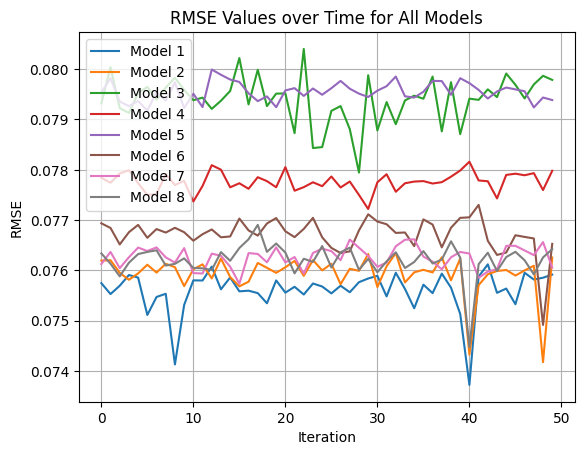

In [18]:
import matplotlib.pyplot as plt

rmse_vals = [[item[0]['test/rmse'] for item in test_values] for test_values in all_models_test_values]

time = range(len(rmse_vals[0]))

for i, model_rmse_values in enumerate(rmse_vals, start=1):
    plt.plot(time, model_rmse_values, label=f"Model {i}")

plt.xlabel("Iteration")
plt.ylabel("RMSE")
plt.title("RMSE Values over Time for All Models")
plt.legend()
plt.grid(True)
plt.show()

In [19]:
import numpy as np

rmse_vals = [[item[0]['test/rmse'] for item in test_values] for test_values in all_models_test_values]

# Calculate the mean RMSE across all models for each iteration
mean_rmse_per_iteration = np.mean(rmse_vals, axis=0)

# Find the iteration with the minimum mean RMSE
best_iteration = np.argmin(mean_rmse_per_iteration)

print(f"The iteration with the lowest average RMSE across all models is: {best_iteration}")
print(f"The lowest average RMSE value is: {mean_rmse_per_iteration[best_iteration]}")

The iteration with the lowest average RMSE across all models is: 40
The lowest average RMSE value is: 0.07665138505399227


In [28]:
trainers_best = [sublist[best_iteration] for sublist in all_trainers]
trained_models_best = [sublist[best_iteration] for sublist in all_trained_models]

In [29]:
# Save the models
trainers_best[0].save_checkpoint("fine_tuned_mpnn_1.ckpt")
trainers_best[1].save_checkpoint("fine_tuned_mpnn_2.ckpt")
trainers_best[2].save_checkpoint("fine_tuned_mpnn_3.ckpt")
trainers_best[3].save_checkpoint("fine_tuned_mpnn_4.ckpt")
trainers_best[4].save_checkpoint("fine_tuned_mpnn_5.ckpt")
trainers_best[5].save_checkpoint("fine_tuned_mpnn_6.ckpt")
trainers_best[6].save_checkpoint("fine_tuned_mpnn_7.ckpt")
trainers_best[7].save_checkpoint("fine_tuned_mpnn_8.ckpt")

# Load the checkpoints and update the 'output_size' in 'hyper_parameters'
checkpoints = []
for i in range(1, 9):
    checkpoint = torch.load(f"fine_tuned_mpnn_{i}.ckpt")
    checkpoint['hyper_parameters']['agg']['output_size'] = 2200
    torch.save(checkpoint, f"fine_tuned_mpnn_{i}.ckpt")
    checkpoints.append(checkpoint)

# Test loading each model
for i in range(1, 9):
    reloaded = models.MPNN.load_from_checkpoint(f"fine_tuned_mpnn_{i}.ckpt")
    print(f"Fine-tuned MPNN {i} reloaded successfully: {reloaded}")

Fine-tuned MPNN 1 reloaded successfully: MPNN(
  (message_passing): BondMessagePassing(
    (W_i): Linear(in_features=147, out_features=2200, bias=False)
    (W_h): Linear(in_features=2200, out_features=2200, bias=False)
    (W_o): Linear(in_features=2333, out_features=2200, bias=True)
    (dropout): Dropout(p=0.05, inplace=False)
    (tau): ReLU()
  )
  (agg): AttentiveAggregation(
    (W): Linear(in_features=2200, out_features=1, bias=True)
  )
  (bn): Identity()
  (predictor): RegressionFFN(
    (ffn): MLP(
      (0): Linear(in_features=2200, out_features=2200, bias=True)
      (1): ReLU()
      (2): Dropout(p=0.05, inplace=False)
      (3): Linear(in_features=2200, out_features=2200, bias=True)
      (4): ReLU()
      (5): Dropout(p=0.05, inplace=False)
      (6): Linear(in_features=2200, out_features=2200, bias=True)
      (7): ReLU()
      (8): Dropout(p=0.05, inplace=False)
      (9): Linear(in_features=2200, out_features=2200, bias=True)
      (10): ReLU()
      (11): Dropout(p

In [ ]:
# Select the 47th iteration of each model
selected_iteration = 46  # Index starts from 0, so 47th iteration has index 46

selected_predictions = [model_predictions[selected_iteration] for model_predictions in all_models_predictions]

# Print the selected predictions for each model
for i, model_predictions in enumerate(selected_predictions, start=1):
    print(f"Predictions for Model {i} at iteration {selected_iteration + 1}:")
    print(model_predictions)
    print()
    

In [ ]:
selected_predictions_array = [[tensor.float() for tensor in pred_list] for pred_list in selected_predictions]
# Calculate the average predictions across the models
averaged_predictions = np.mean(selected_predictions_array, axis=0)

# Print the averaged predictions
print(f"Averaged predictions for iteration {selected_iteration + 1}:")
print(len(averaged_predictions))

In [ ]:
ft_ensemble_rmse = calculate_rmse(averaged_predictions, [test_loader.dataset[i].y for i in range(len(test_loader.dataset))])

ft_ensemble_sis = calculate_sis(averaged_predictions, [test_loader.dataset[i].y for i in range(len(test_loader.dataset))])

plt.hist(ft_ensemble_rmse, bins=26)

plt.hist(ft_ensemble_sis, bins=26)



In [ ]:
arr = np.array(ft_ensemble_sis)

# Find the indexes of the desired values
median_index = np.argsort(arr)[len(arr) // 2]
min_index = np.argmin(arr)
max_index = np.argmax(arr)
q25_index = np.argsort(arr)[len(arr) // 4]
q75_index = np.argsort(arr)[int(len(arr) * 0.75)]

# Find the indexes of the 10th to 90th percentile values
percentile_indexes = [np.argsort(arr)[int(len(arr) * p / 100)] for p in range(10, 100, 10)]

# Print the results
print("Median index:", median_index)
print("Min index:", min_index)
print("Max index:", max_index)
print("25th quartile index:", q25_index)
print("75th quartile index:", q75_index)
print("Percentile indexes (10-90):", percentile_indexes)

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming you have the following variables:
# - averaged_predictions: array of predicted spectra
# - test_loader: DataLoader object containing the test dataset
# - nist_test_df: DataFrame containing the SMILES strings
# - min_index, max_index, q25_index, q75_index, percentile_indexes: indexes obtained from the previous code

# Plot the spectra for the remaining indexes
indexes = [min_index, max_index, q25_index, q75_index] + percentile_indexes
labels = ['Min', 'Max', '25th Quartile', '75th Quartile'] + [f'{p}th Percentile' for p in range(10, 100, 10)]

# Create a figure with subplots based on the number of indexes
num_plots = len(indexes)
num_cols = 3
num_rows = (num_plots + num_cols - 1) // num_cols
fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4*num_rows))
axs = axs.flatten()

for i, (index, label) in enumerate(zip(indexes, labels)):
    print(f"Plotting {label} spectrum at index {index}")
    
    if 0 <= index < len(averaged_predictions) and 0 <= index < len(test_loader.dataset):
        axs[i].plot(np.arange(400, 4002, 2), averaged_predictions[index].squeeze(), label="Predicted Spectrum")
        axs[i].plot(np.arange(400, 4002, 2), -test_loader.dataset[index].y, label="Experimental Spectrum")
        axs[i].set_yticks([])
        axs[i].set_xlabel('Wavelength (nm)')
        axs[i].set_ylabel('Absorbance')
        axs[i].set_title(f'{label} Predicted Spectrum')
        axs[i].legend()
        
        smiles_string = nist_test_df.iloc[index, -1]
        axs[i].text(0.5, -0.15, f'SMILES: {smiles_string}', transform=axs[i].transAxes, ha='center', fontsize=8)
    else:
        print(f"Skipping {label} spectrum due to invalid index {index}")

# Remove any unused subplots
for i in range(len(indexes), len(axs)):
    fig.delaxes(axs[i])

plt.tight_layout()
import os

directory = r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\figures"
if not os.path.exists(directory):
    os.makedirs(directory)

    
plt.savefig(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\figures\predicted_spectra.png", dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Assuming you have the following variables:
# - averaged_predictions: array of predicted spectra
# - test_loader: DataLoader object containing the test dataset
# - nist_test_df: DataFrame containing the SMILES strings
# - min_index, max_index, q25_index, q75_index, percentile_indexes: indexes obtained from the previous code

# Create a directory to save the figures
output_dir = r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\figures"
os.makedirs(output_dir, exist_ok=True)

# Plot the spectra for each index separately
indexes = [min_index, max_index, q25_index, q75_index] + percentile_indexes
labels = ['Min', 'Max', '25th Quartile', '75th Quartile'] + [f'{p}th Percentile' for p in range(10, 100, 10)]

for index, label in zip(indexes, labels):
    print(f"Plotting {label} spectrum at index {index}")
    
    if 0 <= index < len(averaged_predictions) and 0 <= index < len(test_loader.dataset):
        fig, ax = plt.subplots(figsize=(8, 6))
        ax.plot(np.arange(400, 4002, 2), averaged_predictions[index].squeeze(), label="Predicted Spectrum")
        ax.plot(np.arange(400, 4002, 2), -test_loader.dataset[index].y, label="Experimental Spectrum")
        ax.set_yticks([])
        ax.set_xlabel('Wavelength (nm)')
        ax.set_ylabel('Absorbance')
        ax.set_title(f'{label} Predicted Spectrum')
        ax.legend()
        
        smiles_string = nist_test_df.iloc[index, -1]
        ax.text(0.5, -0.15, f'SMILES: {smiles_string}', transform=ax.transAxes, ha='center', fontsize=8)
        
        # Save the figure
        filename = f"{label.lower().replace(' ', '_')}_predicted_spectrum.png"
        filepath = os.path.join(output_dir, filename)
        plt.savefig(filepath, dpi=300, bbox_inches='tight')
        plt.close(fig)
    else:
        print(f"Skipping {label} spectrum due to invalid index {index}")

In [ ]:
# ft_ensemble_results = pd.DataFrame({
#     "rmse": ft_ensemble_rmse,
#     "sis": ft_ensemble_sis
# })

# ft_ensemble_results.to_csv(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\results\ft_ensemble_results_qm9s.csv", index=False)

# ft_ensemble_results.describe()




In [30]:
import numpy as np
import torch
from lightning import pytorch as pl

def train_and_test(model, train_dataloader, test_dataloader, num_epochs, num_cycles):
    """
    Trains and tests a model for multiple cycles.

    Args:
        model (pl.LightningModule): The model to train and test.
        train_dataloader (DataLoader): The data loader for the training dataset.
        test_dataloader (DataLoader): The data loader for the test dataset.
        num_epochs (int): The number of epochs to train per cycle.
        num_cycles (int): The number of cycles to perform.

    Returns:
        tuple: A tuple containing the following elements:
            - all_test_values (list): A list of test values for each cycle.
            - all_predictions (list): A list of predictions for each cycle.
            - model (pl.LightningModule): The trained model after the last cycle.
            - trainer (pl.Trainer): The PyTorch Lightning trainer used for training.
    """
    trainer = pl.Trainer(
        precision='bf16-mixed',
        logger=True,
        enable_checkpointing=False,
        enable_progress_bar=True,
        accelerator="auto",
        devices=1,
        max_epochs=num_epochs,
    )
    
    all_test_values = []
    all_predictions = []
    
    for cycle in range(num_cycles):
        print(f"Cycle {cycle + 1}")
        
        trainer.fit(model, train_dataloader)
        
        test_values = trainer.test(model, test_dataloader)
        predictions = trainer.predict(model, test_dataloader)
        
        all_test_values.append(test_values)
        all_predictions.append(predictions)
        
        print("Predictions:", predictions)
    
    return all_test_values, all_predictions, model, trainer

def fine_tune_models(pre_trained_models, train_dataloaders, test_loader, num_epochs_per_cycle, num_cycles):
    """
    Fine-tunes a list of pre-trained models using their corresponding train dataloaders.

    Args:
        pre_trained_models (list): A list of pre-trained models.
        train_dataloaders (list): A list of train dataloaders corresponding to each pre-trained model.
        test_loader (DataLoader): The data loader for the test dataset.
        num_epochs_per_cycle (int): The number of epochs to train per cycle.
        num_cycles (int): The number of cycles to perform.

    Returns:
        tuple: A tuple containing the following elements:
            - all_models_test_values (list): A list of test values for each fine-tuned model.
            - all_models_predictions (list): A list of predictions for each fine-tuned model.
            - all_models (list): A list of fine-tuned models.
            - all_trainers (list): A list of PyTorch Lightning trainers used for fine-tuning each model.
    """
    all_models_test_values = []
    all_models_predictions = []
    all_models = []
    all_trainers = []

    for i, (model, train_dataloader) in enumerate(zip(pre_trained_models, train_dataloaders), start=1):
        print(f"Fine-tuning pre_trained_model_{i}")
        
        test_values, predictions, trained_model, trainer = train_and_test(
            model, train_dataloader, test_loader, num_epochs_per_cycle, num_cycles
        )
        
        all_models_test_values.append(test_values)
        all_models_predictions.append(predictions)
        all_models.append(trained_model)
        all_trainers.append(trainer)

    return all_models_test_values, all_models_predictions, all_models, all_trainers

def find_best_iteration(all_models_test_values):
    """
    Finds the iteration with the lowest average RMSE across all models.

    Args:
        all_models_test_values (list): A list of test values for each model.

    Returns:
        int: The iteration with the lowest average RMSE.
    """
    rmse_vals = [[item[0]['test/rmse'] for item in test_values] for test_values in all_models_test_values]
    mean_rmse_per_iteration = np.mean(rmse_vals, axis=0)
    best_iteration = np.argmin(mean_rmse_per_iteration)
    return best_iteration

def save_models(trainers, iteration, checkpoint_name_prefix):
    """
    Saves the models at the specified iteration.

    Args:
        trainers (list): A list of PyTorch Lightning trainers.
        iteration (int): The iteration at which to save the models.
        checkpoint_name_prefix (str): The prefix for the checkpoint file names.
    """
    for i, trainer in enumerate(trainers, start=1):
        checkpoint_name = f"{checkpoint_name_prefix}_{i}.ckpt"
        trainer.save_checkpoint(checkpoint_name)

def load_models(checkpoint_name_prefix, num_models, model_class):
    """
    Loads the saved models and updates the 'output_size' in 'hyper_parameters'.

    Args:
        checkpoint_name_prefix (str): The prefix for the checkpoint file names.
        num_models (int): The number of models to load.
        model_class (type): The class of the model.

    Returns:
        list: A list of loaded models.
    """
    models = []
    for i in range(1, num_models + 1):
        checkpoint_name = f"{checkpoint_name_prefix}_{i}.ckpt"
        checkpoint = torch.load(checkpoint_name)
        checkpoint['hyper_parameters']['agg']['output_size'] = 2200
        torch.save(checkpoint, checkpoint_name)
        model = model_class.load_from_checkpoint(checkpoint_name)
        models.append(model)
        print(f"Model {i} reloaded successfully: {model}")
    return models

# Tests
def test_find_best_iteration():
    all_models_test_values = [
        [{'test/rmse': 0.5}, {'test/rmse': 0.4}, {'test/rmse': 0.3}],
        [{'test/rmse': 0.6}, {'test/rmse': 0.5}, {'test/rmse': 0.4}],
        [{'test/rmse': 0.7}, {'test/rmse': 0.6}, {'test/rmse': 0.5}]
    ]
    assert find_best_iteration(all_models_test_values) == 2

def test_save_and_load_models(tmpdir):
    class DummyTrainer:
        def save_checkpoint(self, checkpoint_name):
            with open(checkpoint_name, 'w') as f:
                f.write('dummy checkpoint')

    class DummyModel:
        @staticmethod
        def load_from_checkpoint(checkpoint_name):
            return f"Loaded model from {checkpoint_name}"

    trainers = [DummyTrainer() for _ in range(3)]
    iteration = 1
    checkpoint_name_prefix = tmpdir.join('dummy_model')

    save_models(trainers, iteration, checkpoint_name_prefix)
    loaded_models = load_models(checkpoint_name_prefix, len(trainers), DummyModel)

    assert len(loaded_models) == len(trainers)
    assert all(isinstance(model, str) and model.startswith('Loaded model from') for model in loaded_models)

# Run the tests
test_find_best_iteration()
test_save_and_load_models('/path/to/temporary/directory')

KeyError: 0